<img align="right" width="400" src="https://www.fhnw.ch/de/++theme++web16theme/assets/media/img/fachhochschule-nordwestschweiz-fhnw-logo.svg" alt="FHNW Logo">


# Preparation of Training Data

by Fabian Märki

## Summary
The aim of this notebook is to show how text can be cleaned, tokenized and stemmed in order to prepare it as training data for a downstream nlp task. It uses language detection to identify text that is written in an unexpected language (in this case other than german) so it can be removed from the data (since the trained model is supposed to work on german text). It also visualizes the data in various ways in order to decide upon reasonable stopwords that can be removed from the training data. It then uses some simple count features to identify malformed/outlier data that need extra consideration.

This notebook contains assigments: <font color='red'>Questions are written in red.</font>

<a href="https://colab.research.google.com/github/markif/2024_HS_CAS_NLP_LAB_Notebooks/blob/master/02_a_Preparation_of_Training_Data.ipynb">
  <img align="left" src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

In [1]:
%%capture

!pip install 'fhnw-nlp-utils>=0.10.0,<0.11.0'

from fhnw.nlp.utils.processing import parallelize_dataframe
from fhnw.nlp.utils.processing import is_iterable
from fhnw.nlp.utils.storage import download
from fhnw.nlp.utils.storage import save_dataframe
from fhnw.nlp.utils.storage import load_dataframe
from fhnw.nlp.utils.text import join_tokens

import pandas as pd
import numpy as np

In [2]:
from fhnw.nlp.utils.system import set_log_level
from fhnw.nlp.utils.system import system_info

set_log_level()
print(system_info())

2024-11-30 14:17:29.067476: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-30 14:17:29.083801: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-30 14:17:29.089005: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


OS name: posix
Platform name: Linux
Platform release: 6.8.0-47-generic
Python version: 3.11.0rc1
CPU cores: 6
RAM: 31.11GB total and 23.63GB available
Tensorflow version: 2.17.0
GPU is available
GPU is a NVIDIA GeForce RTX 2070 with Max-Q Design with 8192MiB


/usr/local/lib/python3.11/dist-packages/pynvml/smi.py:5: FutureWarning: The pynvml.smi module is deprecated and will be removed in the next release of pynvml. Please use pynvml_utils:
(e.g. `from pynvml_utils import nvidia_smi`)
  warnings.warn(


Download data and load it into a pandas dataframe.

In [3]:
download("https://drive.switch.ch/index.php/s/IN4vgJEsvULC0K1/download", "data/german_doctor_reviews_original.parq")
data = load_dataframe("data/german_doctor_reviews_original.parq")

Get a first impression...

In [4]:
print(data.shape)
data.head(3)

(357899, 2)


,text_original,rating
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0


Check how many empty cells each column has.

In [5]:
for col in data.columns:
    print(col, data[col].isnull().sum())

text_original 0
rating 7658


Drop all empty rows (in some situations in can also make sense to amend the data - training data is valuable)

<font color='red'>**TASK: Drop all rows with an empty cell and store the result in `data`.**</font>

In [6]:
# TODO: !!! place your code here !!!
####################################


###################
# TODO: !!! end !!!

(350241, 2)

Check if text contains HTML tags.

In [7]:
data[data["text_original"].str.contains("/>", na=False)]

,text_original,rating
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0
4,"Frau Dr. Vetter kenne ich seit vielen Jahren, ...",1.0
10,Bei der Ärztin selbst fühle ich micht stets gu...,2.0
12,Bin seit Januar bei Dr. Henning in Behandlung ...,1.0
13,1. Termin:<br />\n1 Stunde Wartezimmer + 2 min...,6.0
...,...,...
357886,Vor paar Tagen hatte ich eine Ultraschallunter...,4.0
357887,Unglaublich unfreundliche Praxis.<br />\nDie S...,5.0
357890,Ich war einige Jahre lang Patientin bei Dr. Ge...,4.0
357897,Ich bin schon länger bei Frau Dr. Sonntag in B...,4.0


It seems the text needs cleaning (remove html tags etc.).

<font color='red'>**TASK: Implement `clean_text` and provide the functionality as described in the function documentation.**</font>

Hints:
- focus on one functionality at a time
- you do not need to implement all functionalities (there is a reference solution)

Possible Inspirations:
- [Text Data Preprocessing: A Walkthrough in Python](https://www.kdnuggets.com/2018/03/text-data-preprocessing-walkthrough-python.html)
- [Beautiful Soup](https://beautiful-soup-4.readthedocs.io/en/latest) for html tag removal (see also [here](https://stackoverflow.com/a/12982689))

Possible Improvements:
- Replace numbers with a special token
- Replace ä, ö, ü and ß with ae, oe, ue and ss (see [here](https://jdvala.github.io/blog.io/thesis/2018/05/11/German-Preprocessing.html))
- Keep specific word forms only (e.g. all nouns and adjectives - see also [here](https://stackoverflow.com/a/15278298))
- German has many compound words like *Behandlungsdauer*, *Behandlungsempfehlung*, *Behandlungserfolg*, *Behandlungsergebnis* etc. which count for different words (and are thus considered unrelated) in a bag-of-words (BOW) model. Splitting such words could bring some improvement (e.g. see [here](https://github.com/dtuggener/CharSplit) and [here](https://github.com/TimKam/compound-word-splitter))

In [8]:
def clean_text(text, keep_punctuation=False):
    """Cleans text by removing html tags, non ascii chars, digits and optionally punctuation

    Parameters
    ----------
    text : str
        The text to clean
    keep_punctuation : bool
        Defines if punctuation should be kept
        
    Returns
    -------
    str
        The cleaned text
    """
        
    # TODO: !!! place your code here !!!
    ####################################
     
    
    ###################
    # TODO: !!! end !!!

    return text

Let's test some examples:

In [9]:
print(clean_text("Ein Arzt."))
print(clean_text("Ein Arzt.", keep_punctuation=True))
print(clean_text("Ein <br> Arzt."))
print(clean_text("Ein 0815 Arzt."))
print(clean_text("Ein Ârzt भारत"))

Ein Arzt 
Ein Arzt.
Ein Arzt 
Ein Arzt 
Ein Ârzt 


Clean the text in *text_original* and store it in *text*.

In [10]:
%%time

# drop in case of re-execution
data = data.drop(["text"], axis=1, errors='ignore')
data = parallelize_dataframe(data, clean_text, field_read="text_original", field_write="text", keep_punctuation=True)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 1.16 s, sys: 497 ms, total: 1.66 s
Wall time: 3.42 s


Double check... 

In [11]:
data[data["text"].str.contains("/>", na=False)]

,text_original,rating,text


Check for text without characters

In [12]:
data[~data["text"].str.contains("[A-Za-z]", na=False)]

,text_original,rating,text
510,".......,,,,,,,,,,,,,,,,,,,,,,",1.0,".......,,,,,,,,,,,,,,,,,,,,,,"
4763,----------------------------------------------...,3.0,
4928,1111111111111111111111111111111111111111111111...,1.0,
7489,.,1.0,.
17622,.................................................,5.0,.................................................
61490,.................................................,1.0,.................................................
204685,:-),1.0,
305991,... ... ... ... ... ... ... ... ... ... ... .....,1.0,... ... ... ... ... ... ... ... ... ... ... .....
309063,....!,5.0,....!


<font color='red'>**TASK: Drop all rows identified above and store the result in `data`.**</font>

In [13]:
# TODO: !!! place your code here !!!
####################################


###################
# TODO: !!! end !!!

(350232, 3)

Double check... 

In [14]:
data[~data["text"].str.contains("[A-Za-z]", na=False)]

,text_original,rating,text


We analyze german text. Let's try to identify non-german text.

<font color='red'>**TASK: Use fastText to implement `predict_lang` and predict the language of the provided text.**</font>

Possible Inspirations:
- [Identify text language](https://amitness.com/2019/07/identify-text-language-python)

In [15]:
!pip install fasttext

import fasttext

pretrained_model = "fasttext/supervised-models/lid.176.ftz"
download(url="https://dl.fbaipublicfiles.com/"+pretrained_model, path = pretrained_model)
model = fasttext.load_model(pretrained_model)


[notice] A new release of pip is available: 24.1.2 -> 24.3.1
[notice] To update, run: python3 -m pip install --upgrade pip


In [16]:
def predict_lang(text):
    """Predicts the language of a sentence

    Parameters
    ----------
    text : str
        The text to predict the language
    model: fasttext model
        Fasttext model to predict the language
        
    Returns
    -------
    str
        The predicted language (e.g. en, de, fr, it, es, ru, ...)
    """
    
    # TODO: !!! place your code here !!!
    ####################################
    # !!! this needs rework !!!
    
    return "en"

    ###################
    # TODO: !!! end !!!

In [17]:
%%time
data = parallelize_dataframe(data, predict_lang, n_jobs=6, field_read="text", field_write="lang")

# In case you get an error message "NameError: name 'model' is not defined" on your local machine
# you can also execute the above code as follows (without parallelization)
# data = pd.concat([data, data["text"].map(predict_lang).to_frame("lang")], axis=1)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 1 s, sys: 274 ms, total: 1.28 s
Wall time: 4.65 s


In [18]:
data.head(3)

,text_original,rating,text,lang
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,de
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,de
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,de


In [19]:
# get a summary of all predicted languages
data["lang"].value_counts()

lang
de    349901
en       238
pl        17
nl        15
it         9
es         7
sv         6
fi         4
hu         4
al         3
da         3
fr         3
eu         2
ro         2
jb         2
sr         2
ru         2
la         2
pt         2
gl         1
ba         1
oc         1
no         1
nd         1
sl         1
tr         1
ko         1
Name: count, dtype: int64

In [20]:
#pd.options.display.max_rows = None
data.loc[data["lang"] != "de"]

,text_original,rating,text,lang
5,Dieser Mann weiss was er tut.,1.0,Dieser Mann weiss was er tut.,en
1134,HERVORHAGEND::::::::::::::::::::::::::::::::::...,1.0,HERVORHAGEND,hu
2021,Bisher i.O.,2.0,Bisher .,en
2827,Katastrophe .........,6.0,Katastrophe .........,fr
3060,Super Kerl!!!! Super Praxisteam!!!! Super Prop...,1.0,Super Kerl!!!! Super Praxisteam!!!! Super Prop...,en
...,...,...,...,...
351661,Perfect doctor.Very competent and friendly,1.0,Perfect doctor Very competent and friendly,en
355577,Sehr Gut !,1.0,Sehr Gut !,sr
356190,Dr Dudik is the best gynecologist I have had. ...,1.0,Dr Dudik is the best gynecologist have had. An...,en
356684,He is very good and calm. Took care very well,1.0,He is very good and calm. Took care very well,en


Check each individual row to see if it really contains non german text. Alternatively, you might just want to delete all non german predicted rows (but remember, training data is valuable).

In [21]:
# handcrafted
delete_rows = [23666,32836,36789,37056,38863,41619,52122,59717,69225,70454,71649,75865,82514,89963,91433,93172,94829,94897,94965,101568,108747,115867,118969,120108,136188,137354,138723,143134,144365,146786,146971,148011,151936,154651,156848,157620,159678,161340,161340,174741,175238,179085,181464,181997,183575,185626,187205,187743,188892,191245,191729,192939,195947,196182,201934,203209,204340,207086,209502,213146,216070,216527,220184,221750,229629,230812,230927,231132,232964,235550,237095,237743,237932,238321,239181,242175,242671,243060,243227,250396,253465,253790,253819,254323,254760,255987,257958,260406,260446,266847,268197,270367,270374,270815,271952,272747,272836,273203,273924,275617,277243,279420,279477,280796,281613,281673,286529,287505,287768,287890,289947,293835,297010,298277,302994,303077,303479,312723,340714,341344,342168,342185,342222,342257,342369,342830,343944,344666,345929,347115,347539,348001,348727,351661,356190,356684]

In [22]:
data.loc[delete_rows]

,text_original,rating,text,lang
23666,Simply the best,1.0,Simply the best,en
32836,Ausprobieren! Beauty at its best.,1.0,Ausprobieren! Beauty at its best.,en
36789,Tooooooooooooop,1.0,Tooooooooooooop,en
37056,Exelente doctora.,1.0,Exelente doctora.,pt
38863,"Dr. Rösener has a professional staff, modern p...",1.0,"Dr. Rösener has professional staff, modern pra...",en
...,...,...,...,...
348001,Nothing I can complain about. Explanations wer...,1.0,Nothing can complain about. Explanations were ...,en
348727,Both doctor Kettner and doctor Harz are profes...,1.0,Both doctor Kettner and doctor Harz are profes...,en
351661,Perfect doctor.Very competent and friendly,1.0,Perfect doctor Very competent and friendly,en
356190,Dr Dudik is the best gynecologist I have had. ...,1.0,Dr Dudik is the best gynecologist have had. An...,en


In [23]:
data = data.drop(delete_rows)
data = data.drop(columns=["lang"])
data.shape

(350097, 3)

In [24]:
%%time
save_dataframe(data, "data/german_doctor_reviews_cleaned.parq")

CPU times: user 17.6 s, sys: 278 ms, total: 17.9 s
Wall time: 17.9 s


Resume if needed...

In [25]:
#data = None
if data is None:
    download("https://drive.switch.ch/index.php/s/MRKiyKQHCqxHI47/download", "data/german_doctor_reviews_cleaned.parq")
    data = load_dataframe("data/german_doctor_reviews_cleaned.parq")

### Setup Sentiment

The classification should recognize if a comment has a positive or negative sentiment. Let's assume that a good rating (1-2) caries a positive message whereas a low rating (5-6) caries a negative one (later we will exclude neutral ratings, i.e. the task becomes a binary classification).

In [26]:
data["label"] = "positive"
data.loc[data["rating"] >= 3, "label"] = "neutral"
data.loc[data["rating"] >= 5, "label"] = "negative"

data["sentiment"] = data["label"].apply(lambda x: 1 if x == "positive" else (-1 if x == "negative" else 0))
data = data.astype({"sentiment": "int32"})

In [27]:
data.head(3)

,text_original,rating,text,label,sentiment
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1


### Tokenization and Stemming

Let's define some helper functions for tokenization and stemming (we skip lemmantization here).

<font color='red'>**TASK: Implement `tokenize` and `tokenize_stem` and provide the functionality as described in the function documentation.**</font>

In [28]:
def tokenize(text, stopwords):
    """Tokenizes and lowercases a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
        
    Returns
    -------
    list
        The tokenized text
    """
    from fhnw.nlp.utils.processing import is_iterable
    
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        word_tokens = word_tokenize(text)
    elif is_iterable(text):
        word_tokens = text
    else:
        raise TypeError("Only string or iterable (e.g. list) is supported. Received a "+ str(type(text)))

    # TODO: !!! place your code here !!!
    ####################################


    ###################
    # TODO: !!! end !!!
    
    return word_tokens


def tokenize_stem(text, stopwords, stemmer):
    """Tokenizes, lowercases and stems a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
    stemmer: stemmer
        The stemmer to use (e.g. SnowballStemmer)
        
    Returns
    -------
    list
        The tokenized and stemmed text
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        word_tokens = word_tokenize(text)
    elif is_iterable(text):
        word_tokens = text
    else:
        raise TypeError("Only string or iterable (e.g. list) is supported. Received a "+ str(type(text)))

    # TODO: !!! place your code here !!!
    ####################################
    

    ###################
    # TODO: !!! end !!!
        
    return word_tokens


def normalize(text, stopwords, stemmer=None):
    """Normalizes (e.g. tokenize and stem) and lowercases a text and removes stopwords

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens (in this case tokenization is not applied)
    stopwords : set
        A set of stopword to remove from the tokens
    stemmer: stemmer
        The stemmer to use (e.g. SnowballStemmer) or None to disable stemming
        
    Returns
    -------
    list
        The normalized text
    """
        
    if stemmer is not None:
        return tokenize_stem(text, stopwords, stemmer)
    else:
        return tokenize(text, stopwords)

In [29]:
%%capture

!pip install nltk

import nltk
from nltk.stem.snowball import SnowballStemmer

nltk.download('punkt')
nltk.download('punkt_tab')

stemmer = SnowballStemmer("german")
# set of stopwords to showcase tokenize below
stopwords = {"ein"}
empty_stopwords = set()

Let's test some examples:

In [30]:
print(tokenize("Ein guter Arzt.", stopwords=stopwords))
print(tokenize_stem("Ein guter Arzt.", stopwords=stopwords, stemmer=stemmer))

['guter', 'arzt', '.']
['gut', 'arzt', '.']


### Setup Stopwords

Get the (lowercased) tokens first without removing stopwords in order to come up with a *reasonable* set of stopwords.

In [31]:
%%time
data = parallelize_dataframe(data, normalize, field_read="text", field_write="token_clean", stopwords=empty_stopwords, stemmer=None)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 3.58 s, sys: 1.01 s, total: 4.59 s
Wall time: 31.9 s


Join the lowercased tokens again since some algorithms used later need text instead of tokens.

In [32]:
%%time
data = parallelize_dataframe(data, join_tokens, field_read="token_clean", field_write="text_clean", stopwords=empty_stopwords)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 36.2 s, sys: 2.73 s, total: 39 s
Wall time: 39.8 s


Define the stopwords and use n-gram counts and wordclouds to decide upon words to add to the stopwords.

In [33]:
import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')

stopwords = set(stopwords.words("german"))

stopwords.update([".", ":", ",", ";", "?", "!"])

<font color='red'>**TASK: What do you think about the predefined stopword list (i.e. about words like `nicht` and `kein` ...)**</font>

<font color='green'>Place your answer here.</font>

In [34]:
print(stopwords)

{'eurer', 'und', 'an', 'nach', 'würden', 'deinem', 'dieselben', 'das', 'diese', 'anderen', 'meine', 'wir', 'zwar', 'einige', 'jeden', 'jenem', 'aber', 'seine', 'eurem', 'derer', 'deinen', 'gewesen', 'jenen', 'nichts', 'des', 'ihren', 'dann', 'hatten', 'in', 'für', 'uns', 'sondern', 'wenn', 'wo', 'unserem', 'bei', 'einiger', 'ins', 'weg', 'bist', 'deiner', ';', 'jede', 'diesem', 'von', 'welchen', 'welches', 'werde', 'eines', 'dessen', 'sonst', 'mancher', 'derselbe', 'solche', 'habe', 'jedem', 'mich', 'euch', 'würde', 'nur', '!', 'welche', 'könnte', 'euer', 'andere', 'anderer', 'ihrer', 'unsere', 'hatte', 'werden', 'unter', 'einem', 'wollen', 'sehr', 'ohne', 'einiges', 'dass', 'weil', 'aller', 'einigen', 'anders', 'einer', 'hab', 'ist', 'machen', 'jedes', 'weiter', 'andern', 'manchen', 'alle', 'dort', 'als', 'deines', 'denselben', 'dieser', 'ihres', 'musste', 'dich', 'alles', 'etwas', 'jetzt', 'warst', 'welcher', 'allem', 'ihnen', 'zur', 'zum', 'ihn', 'manche', 'muss', 'wird', 'daß', 'ke

In [35]:
%%time
data = data.drop(columns=["token_stem"], errors='ignore')
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_stem", stopwords=stopwords, stemmer=stemmer)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 37.4 s, sys: 2.87 s, total: 40.2 s
Wall time: 51.4 s


Let's see how frequent the words (and their n-grams) are...

<font color='red'>**TASK: Implement `create_ngram_counts` and provide the functionality as described in the function documentation.**</font>

Possible Inspirations:
- [Apply function to a single DataFrame column](https://stackoverflow.com/a/34962199)
- [Create n-grams](https://stackoverflow.com/a/32307986)
- [collections.Counter](https://docs.python.org/3/library/collections.html#collections.Counter)

In [36]:
def create_ngram_counts(df, n = 2, field_read="token_stem"):
    """Creates the n-gram counts of a column of text tokens

    Parameters
    ----------
    df : dataframe
        The dataframe
    n : int
        The n grams to create (e.g. 2 for bi-gram)
    field_read : str
        The column name to read from (default is token_lemma)
        
    Returns
    -------
    Counter
        The n-gram counts
    """
    from collections import Counter
        
    counter = Counter()
    
    # TODO: !!! place your code here !!!
    ####################################
    

    ###################
    # TODO: !!! end !!!
    
    return counter

def plot_ngram_counts(counter, n_most_common, title="Term frequencies"):
    """Plots the n-gram counts

    Parameters
    ----------
    counter : Counter
        The counter of the n-grams
    n_most_common : int
        The n most common n-grams to plog
    title : str
        The title of the plot
    """
    
    import matplotlib.pyplot as plt
        
    y = [count for tag, count in counter.most_common(n_most_common)]
    x = [tag for tag, count in counter.most_common(n_most_common)]

    plt.bar(x, y)
    plt.title(title)
    plt.ylabel("Frequency")
    #plt.yscale('log') # set log scale for y-axis
    plt.xticks(rotation=90)
    for i, (tag, count) in enumerate(counter.most_common(n_most_common)):
        plt.text(i, count, f' {count} ', rotation=90, ha='center', va='top' if i < 10 else 'bottom', color='white' if i < 10 else 'black')
    plt.xlim(-0.6, len(x)-0.4) # set tighter x lims
    plt.tight_layout() # change the whitespace such that all labels fit nicely
    plt.show()

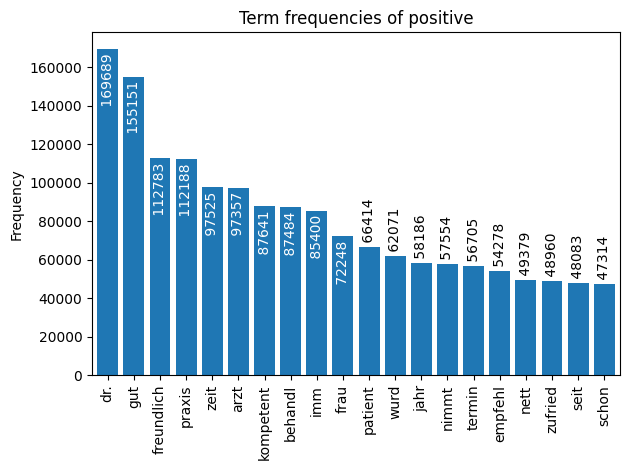

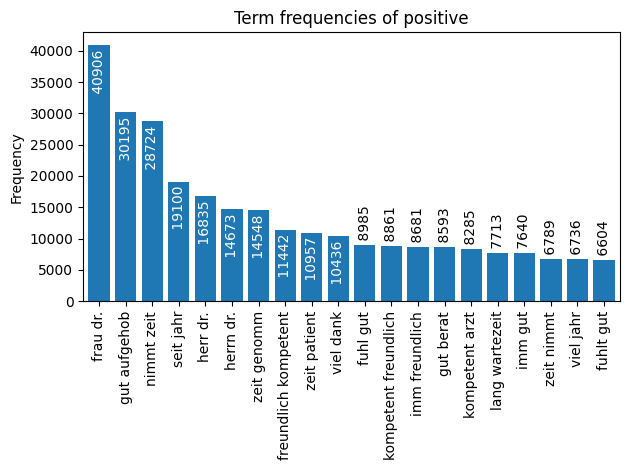

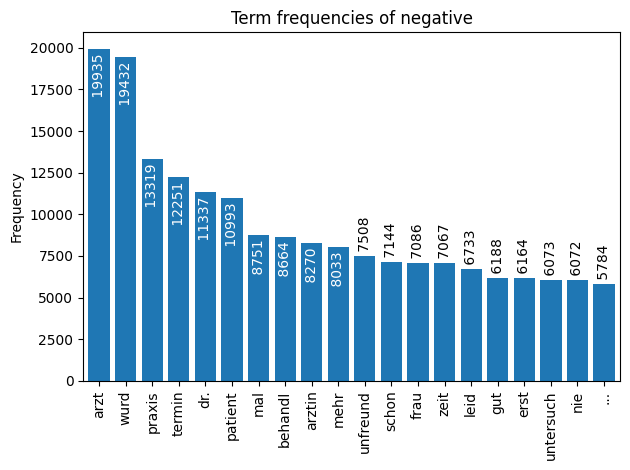

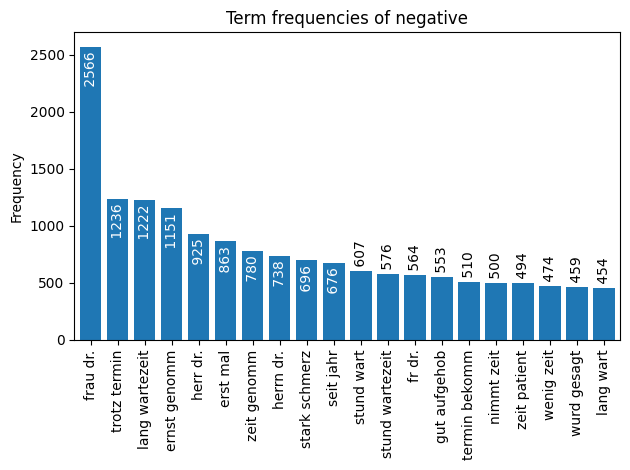

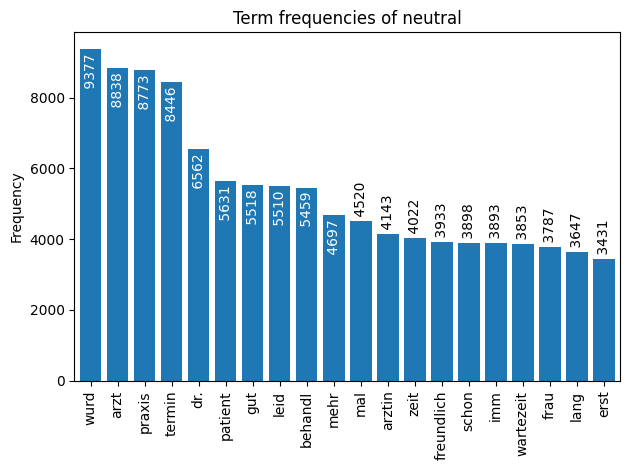

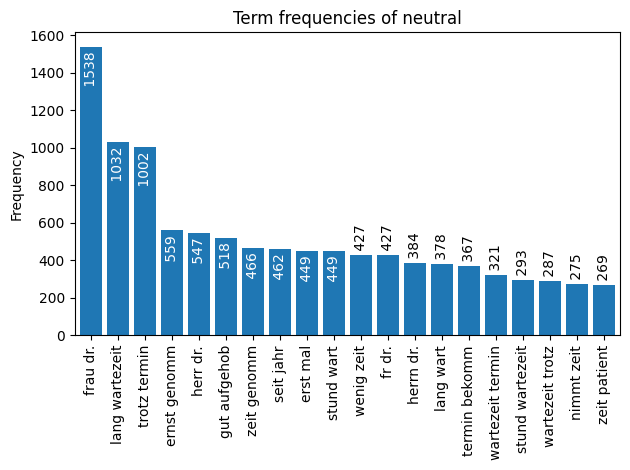

In [37]:
for label in data["label"].unique():
    ngrams_1 = create_ngram_counts(data.loc[(data["label"] == label)], 1)
    ngrams_2 = create_ngram_counts(data.loc[(data["label"] == label)], 2)
    
    plot_ngram_counts(ngrams_1, 20, "Term frequencies of "+label)
    plot_ngram_counts(ngrams_2, 20, "Term frequencies of "+label)

In [38]:
data.head(3)

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_stem
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1,"[ich, bin, franzose, und, bin, seit, ein, paar...",ich bin franzose und bin seit ein paar wochen ...,"[franzos, seit, paar, woch, muench, zahn, schm..."
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1,"[dieser, arzt, ist, das, unmöglichste, was, mi...",dieser arzt ist das unmöglichste was mir in me...,"[arzt, unmog, leb, je, begegnet, unfreund, her..."
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1,"[hatte, akute, beschwerden, am, rücken, ., her...",hatte akute beschwerden am rücken . herr magur...,"[akut, beschwerd, ruck, herr, magura, erst, ar..."


<font color='red'>**TASK: Extend the `stopwords` list with words which do not help to distinguish the classes or are so common that they are considered semantically empty. Additionally, you might want to remove words which can help to distinguish the classes (examine the stopword list).**</font>

In [39]:
# TODO: !!! place your code here !!!
####################################


###################
# TODO: !!! end !!!

Recreate the colums with the extended stopwords 

In [40]:
%%time
data = data.drop(columns=["token_stem"], errors='ignore')
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_stem", stopwords=stopwords, stemmer=stemmer)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 37.1 s, sys: 3.25 s, total: 40.3 s
Wall time: 50.8 s


In [41]:
%%time
data = parallelize_dataframe(data, normalize, field_read="token_clean", field_write="token_clean_stopwords", stopwords=stopwords, stemmer=None)

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 39.1 s, sys: 3.66 s, total: 42.8 s
Wall time: 48.3 s


In [42]:
data.head(3)

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_stem,token_clean_stopwords
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1,"[ich, bin, franzose, und, bin, seit, ein, paar...",ich bin franzose und bin seit ein paar wochen ...,"[franzos, seit, paar, woch, muench, zahn, schm...","[franzose, seit, paar, wochen, muenchen, zahn,..."
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1,"[dieser, arzt, ist, das, unmöglichste, was, mi...",dieser arzt ist das unmöglichste was mir in me...,"[arzt, unmog, leb, je, begegnet, unfreund, her...","[arzt, unmöglichste, leben, je, begegnet, unfr..."
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1,"[hatte, akute, beschwerden, am, rücken, ., her...",hatte akute beschwerden am rücken . herr magur...,"[akut, beschwerd, ruck, magura, erst, arzt, wi...","[akute, beschwerden, rücken, magura, erste, ar..."


In [43]:
%%time
save_dataframe(data, "data/german_doctor_reviews_tokenized.parq")

CPU times: user 52.1 s, sys: 1.03 s, total: 53.1 s
Wall time: 53.1 s


In [44]:
%%time

#data = None
if data is None:
    download("https://drive.switch.ch/index.php/s/6ORDCtABOkeTwk2/download", "data/german_doctor_reviews_tokenized.parq")
    data = load_dataframe("data/german_doctor_reviews_tokenized.parq")

CPU times: user 3 μs, sys: 1 μs, total: 4 μs
Wall time: 4.77 μs


In [45]:
data.head(3)

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_stem,token_clean_stopwords
0,Ich bin franzose und bin seit ein paar Wochen ...,2.0,Ich bin franzose und bin seit ein paar Wochen ...,positive,1,"[ich, bin, franzose, und, bin, seit, ein, paar...",ich bin franzose und bin seit ein paar wochen ...,"[franzos, seit, paar, woch, muench, zahn, schm...","[franzose, seit, paar, wochen, muenchen, zahn,..."
1,Dieser Arzt ist das unmöglichste was mir in me...,6.0,Dieser Arzt ist das unmöglichste was mir in me...,negative,-1,"[dieser, arzt, ist, das, unmöglichste, was, mi...",dieser arzt ist das unmöglichste was mir in me...,"[arzt, unmog, leb, je, begegnet, unfreund, her...","[arzt, unmöglichste, leben, je, begegnet, unfr..."
2,Hatte akute Beschwerden am Rücken. Herr Magura...,1.0,Hatte akute Beschwerden am Rücken. Herr Magura...,positive,1,"[hatte, akute, beschwerden, am, rücken, ., her...",hatte akute beschwerden am rücken . herr magur...,"[akut, beschwerd, ruck, magura, erst, arzt, wi...","[akute, beschwerden, rücken, magura, erste, ar..."


<font color='blue'>**Idea: Let's try to extract simple text features which can be used to convert text into vectors so that they can be plotted in 3D and we can see visually if there are *outlier* (i.e. *strange*) reviews.**</font>

<font color='red'>**TASK: Implement `char_count`, `word_count` and `unique_words` and provide the functionality as described in the function documentation.**</font>

<font color='blue'>**Can you think of other simple features that can help to identify outlier/strange reviews?** Maybe [this](https://umap-learn.readthedocs.io/en/latest/outliers.html) could help but we would need an [embedding](https://umap-learn.readthedocs.io/en/latest/document_embedding.html) (i.e. vectors) first.</font>

In [46]:
def char_count(text):
    """Counts the characters of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The character count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        text = text
    elif is_iterable(text):
        from fhnw.nlp.utils.text import join_tokens
        text = join_tokens(text)
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text))) 

    # TODO: !!! place your code here !!!
    ####################################
    

    ###################
    # TODO: !!! end !!!


def word_count(text):
    """Counts the words of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The word count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        tokens = word_tokenize(text)
    elif is_iterable(text):
        tokens = text
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text))) 
    
    # TODO: !!! place your code here !!!
    ####################################
    

    ###################
    # TODO: !!! end !!!


def unique_words(text):
    """Counts the unique words of a text

    Parameters
    ----------
    text : str, iterable
        The text either as string or iterable of tokens
        
    Returns
    -------
    int
        The unique word count
    """
    from fhnw.nlp.utils.processing import is_iterable
        
    if isinstance(text, str):
        from nltk.tokenize import word_tokenize
        tokens = word_tokenize(text)
    elif is_iterable(text):
        tokens = text
    else:
        raise TypeError("Only string or list is supported. Received a "+ str(type(text)))

    # TODO: !!! place your code here !!!
    ####################################
    

    ###################
    # TODO: !!! end !!!


def extract_count_features_df(df, field_read="token_stem"):
    """Extracts count features from a column of text (primarily meant for parallel processing)

    Parameters
    ----------
    df : dataframe
        The dataframe
    field_read : str
        The column name to read from (default is token_lemma)
        
    Returns
    -------
    dataframe
        The dataframe with the count features
    """    
    
    series_char_count = df[field_read].map(
        lambda x: char_count(x)
    )
    series_char_count.rename("char_count", copy=False, inplace=True)
    
    series_word_count = df[field_read].map(
        lambda x: word_count(x)
    )
    series_word_count.rename("word_count", copy=False, inplace=True)
        
    series_unique_words = df[field_read].map(
        lambda x: unique_words(x)
    )
    series_unique_words.rename("unique_words", copy=False, inplace=True)
    
    return pd.concat([series_char_count, series_word_count, series_unique_words], axis=1)

In [47]:
%%time
data = parallelize_dataframe(data, char_count, field_read="token_stem", field_write="char_count")
data = parallelize_dataframe(data, word_count, field_read="token_stem", field_write="word_count")
data = parallelize_dataframe(data, unique_words, field_read="token_stem", field_write="unique_words")

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)
/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 56 s, sys: 6.9 s, total: 1min 2s
Wall time: 1min 4s


<font color='red'>**TASK: The code below does the same calculation but in ~1/3 of the time. Do you have an idea what could cause this difference?**</font>

<font color='green'>Place your answer here.</font>

In [48]:
%%time
data_tmp = parallelize_dataframe(data, extract_count_features_df, processing_mode="df", field_read="token_stem")

/usr/local/lib/python3.11/dist-packages/numpy/core/fromnumeric.py:59: FutureWarning: 'DataFrame.swapaxes' is deprecated and will be removed in a future version. Please use 'DataFrame.transpose' instead.
  return bound(*args, **kwds)


CPU times: user 20.7 s, sys: 2.68 s, total: 23.4 s
Wall time: 24.3 s


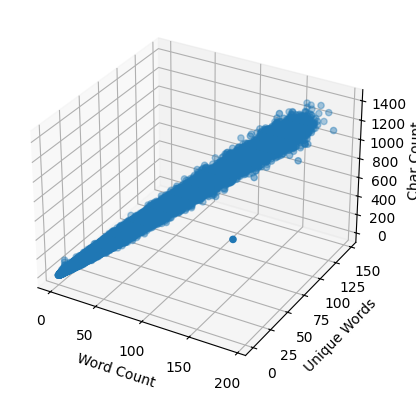

In [49]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data["word_count"], data["unique_words"], data["char_count"])
# ax.scatter(data["word_count"], data["unique_words"], data["char_count"], s=data["char_count"])
ax.set_xlabel('Word Count')
ax.set_ylabel('Unique Words')
ax.set_zlabel('Char Count')

plt.show()

In [50]:
%%capture

!pip install plotly

In [51]:
import plotly
import plotly.express as px

fig = px.scatter_3d(data, x='word_count', y='unique_words', z='char_count', size_max=18, opacity=0.7) #color='cluster', size='char_count',

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

Try to identify outliers (by applying some filters) and remove them (if appropriate).

In [52]:
#pd.options.display.max_rows = None
#data.loc[data["word_count"] > 170]
data.query('(word_count < 1 and unique_words < 1)')

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_stem,token_clean_stopwords,char_count,word_count,unique_words
27685,weiter so,1.0,weiter so,positive,1,"[weiter, so]",weiter so,[],[],0,0,0
30426,Alles so wie es sein soll!,1.0,Alles so wie es sein soll!,positive,1,"[alles, so, wie, es, sein, soll, !]",alles so wie es sein soll !,[],[],0,0,0
42173,Machen Sie weiter so!,1.0,Machen Sie weiter so!,positive,1,"[machen, sie, weiter, so, !]",machen sie weiter so !,[],[],0,0,0
81555,kann´s!,1.0,kann !,positive,1,"[kann, !]",kann !,[],[],0,0,0
161601,weiter so!,1.0,weiter so!,positive,1,"[weiter, so, !]",weiter so !,[],[],0,0,0
294667,ich würde es wieder dort machen,1.0,ich würde es wieder dort machen,positive,1,"[ich, würde, es, wieder, dort, machen]",ich würde es wieder dort machen,[],[],0,0,0
319012,So wie es sein soll,1.0,So wie es sein soll,positive,1,"[so, wie, es, sein, soll]",so wie es sein soll,[],[],0,0,0


In [53]:
data = data.query('~(word_count < 1 and unique_words < 1)')

In [54]:
data.query('word_count > 20 and unique_words < 5 or word_count > 110 and unique_words < 45')

,text_original,rating,text,label,sentiment,token_clean,text_clean,token_stem,token_clean_stopwords,char_count,word_count,unique_words
92350,Top Top Top Top Top Top Top TopTop Top Top Top...,1.0,Top Top Top Top Top Top Top TopTop Top Top Top...,positive,1,"[top, top, top, top, top, top, top, toptop, to...",top top top top top top top toptop top top top...,"[top, top, top, top, top, top, top, toptop, to...","[top, top, top, top, top, top, top, toptop, to...",916,185,2
127512,sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,1.0,sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,positive,1,"[sehr, gut, sehr, gutsehr, gutsehr, gutsehr, g...",sehr gut sehr gutsehr gutsehr gutsehr gutsehr ...,"[gut, gutsehr, gutsehr, gutsehr, gutsehr, guts...","[gut, gutsehr, gutsehr, gutsehr, gutsehr, guts...",183,24,2


In [55]:
data = data.query('~(word_count > 20 and unique_words < 5 or word_count > 110 and unique_words < 45)')

In [56]:
data = data.drop(columns=["char_count", "word_count", "unique_words"], errors='ignore')

Save the data for later model training.

In [57]:
%%time
save_dataframe(data, "data/german_doctor_reviews.parq")

CPU times: user 52.5 s, sys: 671 ms, total: 53.2 s
Wall time: 53.2 s
